# Clone the repo
Get the repo and submodules

In [ ]:
!git clone https://github.com/amadeomarvell/YOLOv7-Car-Logo-Detection.git

Cloning into 'YOLOv7-Car-Logo-Detection'...
remote: Enumerating objects: 425, done.
remote: Counting objects: 100% (77/77), done.
remote: Compressing objects: 100% (64/64), done.
remote: Total 425 (delta 40), reused 22 (delta 7), pack-reused 348
Receiving objects: 100% (425/425), 119.00 MiB | 35.67 MiB/s, done.
Resolving deltas: 100% (199/199), done.


# Clone the repo
Download submodules

In [ ]:
%cd /content/YOLOv7-Car-Logo-Detection/src/yolov7/
!git submodule update --init

/content/YOLOv7-Car-Logo-Detection/src/yolov7
Submodule 'src/yolov7' (https://github.com/WongKinYiu/yolov7.git) registered for path './'
Cloning into '/content/YOLOv7-Car-Logo-Detection/src/yolov7'...
Submodule path './': checked out 'a207844b1ce82d204ab36d87d496728d3d2348e7'


Install the necessary packages.

In [ ]:
!pip install -r /content/YOLOv7-Car-Logo-Detection/src/requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 13.6 MB/s eta 0:00:00


# Download the dataset from google drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
from zipfile import ZipFile

In [ ]:
with ZipFile('/content/drive/MyDrive/Car Logo Dataset 27 Contrasted 2.zip', 'r') as TestZip: TestZip.extractall('/content/YOLOv7-Car-Logo-Detection/Car Logo Dataset 27')

Then, split data into sets.Next, we need to partition the dataset into train, validation, and test sets. These will contain 80%, 10%, and 10% of the data, respectively.

In [ ]:
!python /content/YOLOv7-Car-Logo-Detection/src/prepare_data.py --dataset CarLogos

In [ ]:
import os
import cv2

# Path to the directory containing training images
image_folder = '/content/YOLOv7-Car-Logo-Detection/data/images/train/'

# Path to the directory containing text files with bounding box information
label_folder = '/content/YOLOv7-Car-Logo-Detection/data/annotations/train/'

# Path to the directory where you want to save the cropped images
output_folder = '/content/YOLOv7-Car-Logo-Detection/data/images/train_roi/'
os.makedirs(output_folder, exist_ok=True)

# Path to the directory where you want to save the updated annotations
updated_annotations_folder = '/content/YOLOv7-Car-Logo-Detection/data/annotations/train_roi/'
os.makedirs(updated_annotations_folder, exist_ok=True)

# Path to the directory where you want to save the updated annotations
updated_label_folder = '/content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/'
os.makedirs(updated_label_folder, exist_ok=True)

# Factor to control how much to crop around the bounding box (e.g., 0.5 means crop to 50% of the original image size)
crop_factor = 0.5

# Iterate through each text file in the label folder
for label_file in os.listdir(label_folder):
    if label_file.endswith('.txt'):
        image_name = os.path.splitext(label_file)[0]  # Get the image name without extension

        # Read bounding box information from the text file
        label_file_path = os.path.join(label_folder, label_file)
        with open(label_file_path, 'r') as f:
            line = f.readline().strip()

        # Check if the line is not empty
        if line:
            # Unpack values if there are any
            class_id, x_center, y_center, width, height = map(float, line.split())

            # Read the original image
            image_path = os.path.join(image_folder, f'{image_name}.jpg')  # Assuming image format is JPG
            original_image = cv2.imread(image_path)

            # Calculate bounding box coordinates
            x_min = int((x_center - width / 2) * original_image.shape[1])
            y_min = int((y_center - height / 2) * original_image.shape[0])
            x_max = int((x_center + width / 2) * original_image.shape[1])
            y_max = int((y_center + height / 2) * original_image.shape[0])

            # Calculate the center of the bounding box
            center_x = (x_min + x_max) // 2
            center_y = (y_min + y_max) // 2

            # Calculate the new bounding box coordinates
            new_width = int(original_image.shape[1] * crop_factor)
            new_height = int(original_image.shape[0] * crop_factor)
            new_x_min = max(0, center_x - new_width // 2)
            new_y_min = max(0, center_y - new_height // 2)
            new_x_max = min(original_image.shape[1], new_x_min + new_width)
            new_y_max = min(original_image.shape[0], new_y_min + new_height)

            # Save the updated annotation to the new file
            updated_annotations_file_path = os.path.join(updated_annotations_folder, f'updated_{label_file}')
            with open(updated_annotations_file_path, 'w') as updated_f:
                updated_f.write(f"{class_id} {new_x_min/original_image.shape[1]} {new_y_min/original_image.shape[0]} {new_width/original_image.shape[1]} {new_height/original_image.shape[0]}")

            updated_label_file_path = os.path.join(updated_label_folder, f'updated_{label_file}')
            with open(updated_label_file_path, 'w') as updated_f:
                updated_f.write(f"{class_id} {new_x_min/original_image.shape[1]} {new_y_min/original_image.shape[0]} {new_width/original_image.shape[1]} {new_height/original_image.shape[0]}")

            print(f"Updated annotation saved to {updated_label_file_path}")
        else:
            print(f"Empty annotation file: {label_file_path}")


Updated annotation saved to /content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/updated_3768.txt
Updated annotation saved to /content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/updated_3519.txt
Updated annotation saved to /content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/updated_689.txt
Updated annotation saved to /content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/updated_2193.txt
Updated annotation saved to /content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/updated_5839.txt
Updated annotation saved to /content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/updated_808.txt
Updated annotation saved to /content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/updated_156.txt
Updated annotation saved to /content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/updated_5409.txt
Updated annotation saved to /content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/updated_2124.txt
Updated annotation saved to /content/YOLOv7-Car-Logo-Detection/data/labels/train_roi/

ValueError: ignored

# Start training

In [ ]:
!python /content/YOLOv7-Car-Logo-Detection/src/yolov7/train.py --img-size 480 --cfg /content/YOLOv7-Car-Logo-Detection/src/cfg/training/yolov7.yaml --hyp /content/YOLOv7-Car-Logo-Detection/data/hyp.scratch.yaml --batch 4 --epoch 100 --data /content/YOLOv7-Car-Logo-Detection/data/data.yaml --weights /content/YOLOv7-Car-Logo-Detection/src/yolov7_training.pt --workers 2 --name yolo_logo_det --device 0

2023-12-18 04:59:33.190636: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-18 04:59:33.190689: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-18 04:59:33.192083: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-18 04:59:33.199346: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-12-18 04:59:34.213512: W tensorflow/comp

In [ ]:
# 2nd training
!python /content/YOLOv7-Car-Logo-Detection/src/yolov7/train.py --img-size 480 --cfg /content/YOLOv7-Car-Logo-Detection/src/cfg/training/yolov7.yaml --hyp /content/YOLOv7-Car-Logo-Detection/data/hyp.scratch.yaml --batch 4 --epoch 20 --data /content/YOLOv7-Car-Logo-Detection/data/data.yaml --weights /content/YOLOv7-Car-Logo-Detection/src/yolov7_training.pt --workers 2 --name yolo_logo_det --device 0

2023-12-18 08:47:40.110107: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-18 08:47:40.110160: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-18 08:47:40.111477: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-18 08:47:40.119013: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-12-18 08:47:41.106713: W tensorflow/comp

In [ ]:
# 3rd training
!python /content/YOLOv7-Car-Logo-Detection/src/yolov7/train.py --img-size 480 --cfg /content/YOLOv7-Car-Logo-Detection/src/cfg/training/yolov7.yaml --hyp /content/YOLOv7-Car-Logo-Detection/data/hyp.scratch.yaml --batch 4 --epoch 20 --data /content/YOLOv7-Car-Logo-Detection/data/data.yaml --weights /content/YOLOv7-Car-Logo-Detection/src/yolov7_training.pt --workers 2 --name yolo_logo_det --device 0

2023-12-18 09:26:43.943007: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-18 09:26:43.943063: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-18 09:26:43.944338: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-18 09:26:43.951348: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-12-18 09:26:44.911093: W tensorflow/comp

# Detect test images

Install requirements

In [ ]:
!pip3 install -r /content/YOLOv7-Car-Logo-Detection/requirements.txt

Detect license plates from test images

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
test_images_folder = '/content/YOLOv7-Car-Logo-Detection/data/images/test2/'
wpodnet_model_path = '/content/YOLOv7-Car-Logo-Detection/wpodnet.pth'
annotated_folder = '/content/YOLOv7-Car-Logo-Detection/data/images/annotated_plates/'
warped_folder = '/content/YOLOv7-Car-Logo-Detection/data/images/warped_plates/'
os.makedirs(annotated_folder, exist_ok=True)
os.makedirs(warped_folder, exist_ok=True)
for filename in os.listdir(test_images_folder):
    if filename.endswith('.jpg') or filename.endswith('.jpeg') or filename.endswith('.png'):
        input_image_path = os.path.join(test_images_folder, filename)
        command = f'python3 /content/YOLOv7-Car-Logo-Detection/predict.py {input_image_path} -w {wpodnet_model_path} --save-annotated {annotated_folder} --save-warped {warped_folder}'
        os.system(command)


In [ ]:
import shutil

# Set the path to the directory where the best.pt file is located
source_path = '/content/YOLOv7-Car-Logo-Detection/src/yolov7/runs/train/yolo_logo_det7/weights/best.pt'

# Set the destination path where you want to download the best.pt file
destination_path = '/content/drive/MyDrive/best pt/training 2/'

# Copy the best.pt file to the destination path
shutil.copy(source_path, destination_path)

'/content/drive/MyDrive/best pt/training 2/best.pt'

In [ ]:
# pre-process test images using adaptive equalization
import cv2
import os

# Specify the paths to the input (original) and output (enhanced) folders
input_folder = '/content/YOLOv7-Car-Logo-Detection/data/images/annotated_plates/'
output_folder = '/content/YOLOv7-Car-Logo-Detection/data/images/enhanced_annotated_plates/'

# Create the output folder if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Function to apply adaptive histogram equalization to an image
def apply_adaptive_equalization(image_path, output_path):
    # Read the color image
    img = cv2.imread(image_path)

    # Split the image into color channels
    channels = cv2.split(img)

    # Apply adaptive histogram equalization to each channel independently
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced_channels = [clahe.apply(channel) for channel in channels]

    # Merge the enhanced channels back into a color image
    img_enhanced = cv2.merge(enhanced_channels)

    # Save the enhanced image
    cv2.imwrite(output_path, img_enhanced)

# Iterate through all files in the input folder
for filename in os.listdir(input_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        # Full path to the input and output images
        input_image_path = os.path.join(input_folder, filename)
        output_image_path = os.path.join(output_folder, f'{filename}')

        # Apply adaptive histogram equalization
        apply_adaptive_equalization(input_image_path, output_image_path)

# Display or further process the enhanced images as needed


Detect logos from test images

In [ ]:
!python /content/YOLOv7-Car-Logo-Detection/src/yolov7/detect.py --source /content/YOLOv7-Car-Logo-Detection/data/images/enhanced_annotated_plates --weights /content/YOLOv7-Car-Logo-Detection/src/yolov7/runs/train/yolo_logo_det7/weights/best.pt --img-size 480 --conf 0.10 --name yolo_logo_det

Namespace(weights=['/content/YOLOv7-Car-Logo-Detection/src/yolov7/runs/train/yolo_logo_det7/weights/best.pt'], source='/content/YOLOv7-Car-Logo-Detection/data/images/enhanced_annotated_plates', img_size=480, conf_thres=0.1, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='yolo_logo_det', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-128-ga207844 torch 2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151.125MB)

Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
IDetect.fuse
/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Model Summary: 314 layers, 36622016 p

# Show all test images result

In [ ]:
from IPython.display import Image, display
import os
import shutil

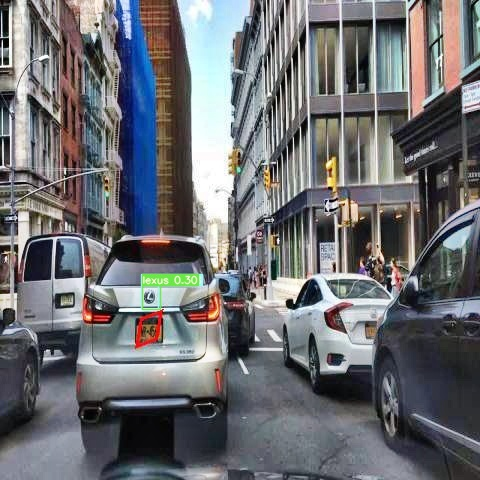

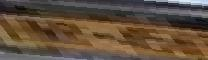

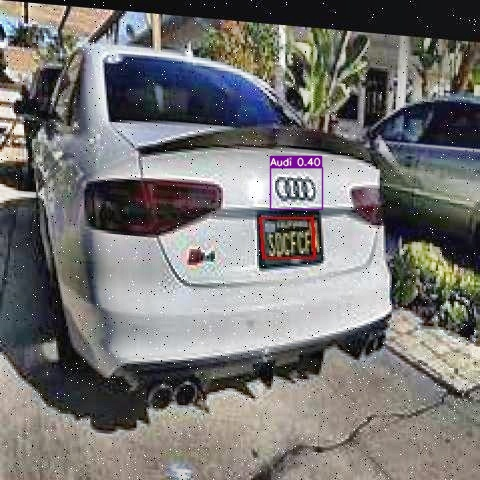

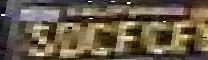

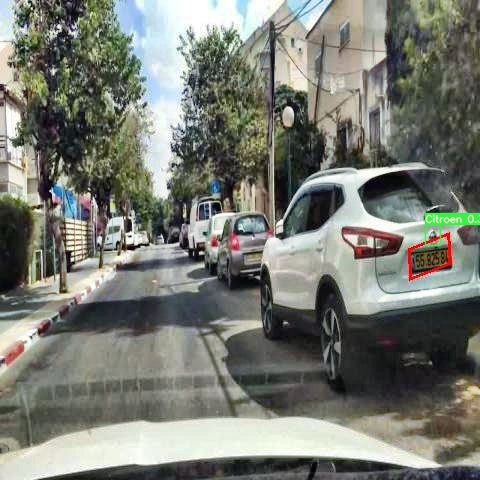

...

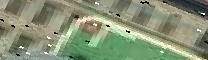

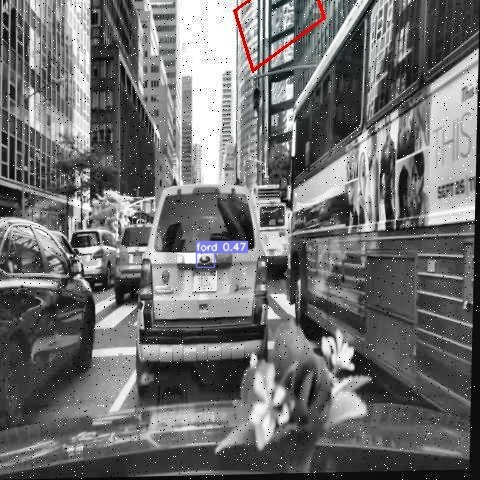

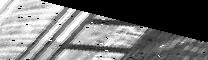

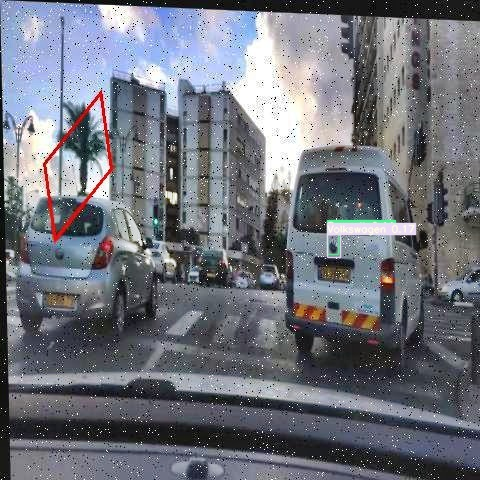

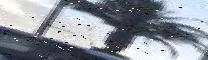

In [ ]:
results_path = '/content/YOLOv7-Car-Logo-Detection/src/yolov7/runs/detect/yolo_logo_det4/'
warped_folder = '/content/YOLOv7-Car-Logo-Detection/data/images/warped_plates/'
drive_folder = '/content/drive/MyDrive/YOLOv7_Car_Logo_Detection_27_Results_Contrasted_2_logo_det_4'
os.makedirs(drive_folder, exist_ok=True)
for filename in os.listdir(results_path):
    if filename.endswith('.jpg'):
        source_path = os.path.join(results_path, filename)
        warped_path = os.path.join(warped_folder, filename)
        destination_path = os.path.join(drive_folder, filename)
        shutil.copyfile(source_path, destination_path)
        shutil.copyfile(warped_path, destination_path)
from IPython.display import Image, display
for filename in os.listdir(results_path):
    if filename.endswith('.jpg'):
        image_path = os.path.join(results_path, filename)
        warped_image_path = os.path.join(warped_folder, filename)
        display(Image(filename=image_path), Image(filename=warped_image_path))